In [2]:
#imports 

import os
import PyPDF2
import pandas as pd
import re
import numpy as np
import pandas as pd
from pprint import pprint
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from nltk.corpus import stopwords
from gensim.models import CoherenceModel
import spacy
import pyLDAvis
import pyLDAvis.gensim_models
import matplotlib.pyplot as plt
import nltk
# set seed for reproducibility
#np.random.seed(493)

import json 
import csv

import nltk
nltk.download('stopwords')
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk import word_tokenize, sent_tokenize
ps = nltk.porter.PorterStemmer()

import unicodedata
import re

from gsdmm import MovieGroupProcess

import openai

nlp=spacy.load('en_core_web_sm',disable=['parser', 'ner'])
stop_words = stopwords.words('english')

import time

from nltk.sentiment.vader import SentimentIntensityAnalyzer



[nltk_data] Downloading package stopwords to C:\Users\Seth
[nltk_data]     Benson\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to C:\Users\Seth
[nltk_data]     Benson\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
C:\Users\Seth Benson\AppData\Roaming\Python\Python310\site-packages\spacy\util.py:877: UserWarning: [W095] Model 'en_core_web_sm' (3.5.0) was trained with spaCy v3.5 and may not be 100% compatible with the current version (3.4.4). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


## Functions for Text Cleaning and Topic Modeling

In [3]:
def tokeniz(sentences):

    for sentence in sentences:

        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))



#function to filter out stopwords
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]



#function for lemmatization
def lemmatize(texts, allowed_postags=['NOUN', 'ADJ', 'VERB']):
    texts_op = []
    for sent in texts:
        doc = nlp(" ".join(sent))
        texts_op.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_op
    
from copy import deepcopy
def top_words(cluster_word_distribution, top_cluster, values):
    words = []
    for cluster in top_cluster:
        sort_dicts =sorted(cluster_word_distribution[cluster].items(), key=lambda k: k[1], reverse=True)[:values]
        words.append([w[0] for w in sort_dicts])
        #print('Cluster %s : %s'%(cluster,sort_dicts))
        #print('-'*120)
    words1 = deepcopy(words)
    for i in range(len(words)):
        for j in range(len(words[i])):
            for k in range(len(words)):
                if k != i and words[i][j] in words[k]:
                    try:
                        words1[i].remove(words[i][j])
                        words1[k].remove(words[i][j])
                    except:
                        pass
    return words1

def create_topics_dataframe(data_text,  mgp, threshold, topic_dict, stem_text):
    result = pd.DataFrame(columns=['text', 'topic', 'stems'])
    for i, text in enumerate(data_text):
        result.at[i, 'text'] = text
        result.at[i, 'stems'] = stem_text[i]
        prob = mgp.choose_best_label(stem_text[i])
        if prob[1] >= threshold:
            result.at[i, 'topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'topic'] = 'Other'
    return result

In [4]:
from contextlib import contextmanager
import sys, os

@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout

In [5]:
#Building Bigram & Trigram Models
#bigram = gensim.models.Phrases(processed_data, min_count=5, threshold=100)
#trigram = gensim.models.Phrases(bigram[processed_data], threshold=100)
#bigram_mod = gensim.models.phrases.Phraser(bigram)
#trigram_mod = gensim.models.phrases.Phraser(trigram)

#function to filter out stopwords
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

#function to create bigrams
def create_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

#function to create trigrams
def create_trigrams(texts):
    [trigram_mod[bigram_mod[doc]] for doc in texts]

#function for lemmatization
def lemmatize(texts, allowed_postags=['NOUN', 'ADJ', 'VERB']):
    texts_op = []
    for sent in texts:
        doc = nlp(" ".join(sent))
        texts_op.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_op

## Organizing Transcript-Topics
Final data saves with transcript, topic keywords, sentiment, and program

In [58]:
tr_tp_st = [[], [], [], []]

gl = pd.read_csv("foxGuestList.csv", encoding="windows-1252")
fox = open("fox_text.txt", "r", encoding="windows-1252")
fox = fox.readlines()
for l in range(len(fox)):
    #######################################
    ##Turning transcript into df of lines##
    #######################################
    lines = pd.DataFrame(
        columns=["Date", "Start_Hour", "Program", "Title", "Speaker", "Line"]
    )
    # print(lines)
    transcript = fox[l]
    meta = gl.iloc[l, :]
    dt = meta["Date"]
    if "January" in str(dt) and ("10" in str(dt) or "11" in str(dt) or "12" in str(dt) or "13" in str(dt)):
        print(l)
        chunks = transcript.split("|")
        line = ""
        spkr = ""
        for c in chunks:
            if (
                "Page" not in c[0:10]
                and "...." not in c
                and c[0:15] not in meta["Title"]
            ):
                # print(c)
                if ":" in c:
                    c = c.split(":")
                    if str.isupper(c[0]):
                        lines.loc[len(lines)] = [
                            meta["Date"],
                            meta["Start_Hour"],
                            meta["Program"],
                            meta["Title"],
                            spkr,
                            line,
                        ]
                        # print(spkr + ':' + line)
                        spkr = c[0]
                        line = c[1]
                else:
                    line += c
        lines.loc[len(lines)] = [
            meta["Date"],
            meta["Start_Hour"],
            meta["Program"],
            meta["Title"],
            spkr,
            line,
        ]

        # cleaning Speaker
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x.strip())
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x.split(","))
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x[0])
        speakers = []
        spkr_list = lines["Speaker"].unique()
        for s in lines["Speaker"]:
            s1 = s.split(" ")
            if len(s1) == 1:
                for s2 in spkr_list:
                    if s1[0] in s2:
                        speakers.append(s2)
                        break
            else:
                speakers.append(s)
        lines["Speaker"] = speakers
        # lines.to_csv('fox_lines_test.csv')
        data = lines["Line"]

        # cleaning text
        processed_data = list(tokeniz(data))

        ####################################
        ##cleaning text for topic modeling##
        ####################################
        # Building Bigram & Trigram Models
        bigram = gensim.models.Phrases(processed_data, min_count=5, threshold=100)
        bigram_mod = gensim.models.phrases.Phraser(bigram)

        # function to filter out stopwords
        def remove_stopwords(texts):
            return [
                [word for word in simple_preprocess(str(doc)) if word not in stop_words]
                for doc in texts
            ]

        # function to create bigrams
        def create_bigrams(texts):
            return [bigram_mod[doc] for doc in texts]

        # removing stopwords, creating bigrams and lemmatizing the text
        data_wo_stopwords = remove_stopwords(processed_data)
        data_bigrams = create_bigrams(data_wo_stopwords)
        data_lemmatized = lemmatize(
            data_bigrams, allowed_postags=["NOUN", "ADJ", "VERB"]
        )

        ######################
        #####TOPIC MODELING###
        ######################

        texts = data_lemmatized
        mgp = MovieGroupProcess(K=5, alpha=0.1, beta=0.1, n_iters=30)

        vocab = set(x for doc in texts for x in doc)
        n_terms = len(vocab)
        with suppress_stdout():
            y = mgp.fit(texts, n_terms)
        doc_count = np.array(mgp.cluster_doc_count)
        top_index = doc_count.argsort()[-10:][::-1]
        tw = top_words(mgp.cluster_word_distribution, top_index, 15)

        topic_dict = {}

        for i, topic_num in enumerate(top_index):
            topic_dict[topic_num] = i

        dfx = create_topics_dataframe(
            data_text=lines["Line"],
            mgp=mgp,
            threshold=0.3,
            topic_dict=topic_dict,
            stem_text=texts,
        )

        transcript = pd.merge(lines, dfx, left_on="Line", right_on="text")

        ######################
        ##Sentiment Analysis##
        ######################
        transcript["stems_str"] = transcript["stems"].apply(lambda x: " ".join(x))
        sid = SentimentIntensityAnalyzer()
        transcript["VADER"] = transcript["Line"].apply(
            lambda x: list(sid.polarity_scores(x).values())[3]
        )

        ######################
        ##Storing Each Topic##
        ######################
        for t in range(len(transcript["topic"].unique())):
            df = transcript[transcript["topic"] == t]

            if len(df) > 2:
                tr_tp_st[0].append(l)
                tr_tp_st[1].append(tw[t])
                tr_tp_st[2].append(df["VADER"].mean())
                tr_tp_st[3].append(lines["Program"][0])


gl = pd.read_csv("msnbcGuestList.csv", encoding="windows-1252")
fox = open("msnbc_text.txt", "r", encoding="windows-1252")
fox = fox.readlines()
for l in range(len(fox)):
    #######################################
    ##Turning transcript into df of lines##
    #######################################
    lines = pd.DataFrame(
        columns=["Date", "Start_Hour", "Program", "Title", "Speaker", "Line"]
    )
    # print(lines)
    transcript = fox[l]
    meta = gl.iloc[l, :]
    dt = meta["Date"]
    if "January" in str(dt) and ("10" in str(dt) or "11" in str(dt) or "12" in str(dt) or "13" in str(dt)):
        print(l)
        chunks = transcript.split("|")
        line = ""
        spkr = ""
        for c in chunks:
            if (
                "Page" not in c[0:10]
                and "...." not in c
                and c[0:15] not in meta["Title"]
            ):
                # print(c)
                if ":" in c:
                    c = c.split(":")
                    if str.isupper(c[0]):
                        lines.loc[len(lines)] = [
                            meta["Date"],
                            meta["Start_Hour"],
                            meta["Program"],
                            meta["Title"],
                            spkr,
                            line,
                        ]
                        # print(spkr + ':' + line)
                        spkr = c[0]
                        line = c[1]
                else:
                    line += c
        lines.loc[len(lines)] = [
            meta["Date"],
            meta["Start_Hour"],
            meta["Program"],
            meta["Title"],
            spkr,
            line,
        ]

        # cleaning Speaker
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x.strip())
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x.split(","))
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x[0])
        speakers = []
        spkr_list = lines["Speaker"].unique()
        for s in lines["Speaker"]:
            s1 = s.split(" ")
            if len(s1) == 1:
                for s2 in spkr_list:
                    if s1[0] in s2:
                        speakers.append(s2)
                        break
            else:
                speakers.append(s)
        lines["Speaker"] = speakers
        # lines.to_csv('fox_lines_test.csv')
        data = lines["Line"]

        # cleaning text
        processed_data = list(tokeniz(data))

        ####################################
        ##cleaning text for topic modeling##
        ####################################
        # Building Bigram & Trigram Models
        bigram = gensim.models.Phrases(processed_data, min_count=5, threshold=100)
        bigram_mod = gensim.models.phrases.Phraser(bigram)

        # function to filter out stopwords
        def remove_stopwords(texts):
            return [
                [word for word in simple_preprocess(str(doc)) if word not in stop_words]
                for doc in texts
            ]

        # function to create bigrams
        def create_bigrams(texts):
            return [bigram_mod[doc] for doc in texts]

        # removing stopwords, creating bigrams and lemmatizing the text
        data_wo_stopwords = remove_stopwords(processed_data)
        data_bigrams = create_bigrams(data_wo_stopwords)
        data_lemmatized = lemmatize(
            data_bigrams, allowed_postags=["NOUN", "ADJ", "VERB"]
        )

        ######################
        #####TOPIC MODELING###
        ######################

        texts = data_lemmatized
        mgp = MovieGroupProcess(K=5, alpha=0.1, beta=0.1, n_iters=30)

        vocab = set(x for doc in texts for x in doc)
        n_terms = len(vocab)
        with suppress_stdout():
            y = mgp.fit(texts, n_terms)
        doc_count = np.array(mgp.cluster_doc_count)
        top_index = doc_count.argsort()[-10:][::-1]
        tw = top_words(mgp.cluster_word_distribution, top_index, 15)

        topic_dict = {}

        for i, topic_num in enumerate(top_index):
            topic_dict[topic_num] = i

        dfx = create_topics_dataframe(
            data_text=lines["Line"],
            mgp=mgp,
            threshold=0.3,
            topic_dict=topic_dict,
            stem_text=texts,
        )

        transcript = pd.merge(lines, dfx, left_on="Line", right_on="text")

        ######################
        ##Sentiment Analysis##
        ######################
        transcript["stems_str"] = transcript["stems"].apply(lambda x: " ".join(x))
        sid = SentimentIntensityAnalyzer()
        transcript["VADER"] = transcript["Line"].apply(
            lambda x: list(sid.polarity_scores(x).values())[3]
        )

        ######################
        ##Storing Each Topic##
        ######################
        for t in range(len(transcript["topic"].unique())):
            df = transcript[transcript["topic"] == t]

            if len(df) > 2:
                tr_tp_st[0].append(l + 2000)
                tr_tp_st[1].append(tw[t])
                tr_tp_st[2].append(df["VADER"].mean())
                tr_tp_st[3].append(lines["Program"][0])

gl = pd.read_csv("cnnGuestList.csv", encoding="windows-1252")
fox = open("cnn_text.txt", "r", encoding="windows-1252")
fox = fox.readlines()
for l in range(len(fox)):
    #######################################
    ##Turning transcript into df of lines##
    #######################################
    lines = pd.DataFrame(
        columns=["Date", "Start_Hour", "Program", "Title", "Speaker", "Line"]
    )
    # print(lines)
    transcript = fox[l]
    meta = gl.iloc[l, :]
    dt = meta["Date"]
    if "January" in str(dt) and ("10" in str(dt) or "11" in str(dt) or "12" in str(dt) or "13" in str(dt)):
        print(l)
        chunks = transcript.split("|")
        line = ""
        spkr = ""
        for c in chunks:
            if (
                "Page" not in c[0:10]
                and "...." not in c
                and c[0:15] not in meta["Title"]
            ):
                # print(c)
                if ":" in c:
                    c = c.split(":")
                    if str.isupper(c[0]):
                        lines.loc[len(lines)] = [
                            meta["Date"],
                            meta["Start_Hour"],
                            meta["Program"],
                            meta["Title"],
                            spkr,
                            line,
                        ]
                        # print(spkr + ':' + line)
                        spkr = c[0]
                        line = c[1]
                else:
                    line += c
        lines.loc[len(lines)] = [
            meta["Date"],
            meta["Start_Hour"],
            meta["Program"],
            meta["Title"],
            spkr,
            line,
        ]

        # cleaning Speaker
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x.strip())
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x.split(","))
        lines["Speaker"] = lines["Speaker"].apply(lambda x: x[0])
        speakers = []
        spkr_list = lines["Speaker"].unique()
        for s in lines["Speaker"]:
            s1 = s.split(" ")
            if len(s1) == 1:
                for s2 in spkr_list:
                    if s1[0] in s2:
                        speakers.append(s2)
                        break
            else:
                speakers.append(s)
        lines["Speaker"] = speakers
        # lines.to_csv('fox_lines_test.csv')
        data = lines["Line"]

        # cleaning text
        processed_data = list(tokeniz(data))

        ####################################
        ##cleaning text for topic modeling##
        ####################################
        # Building Bigram & Trigram Models
        bigram = gensim.models.Phrases(processed_data, min_count=5, threshold=100)
        bigram_mod = gensim.models.phrases.Phraser(bigram)

        # function to filter out stopwords
        def remove_stopwords(texts):
            return [
                [word for word in simple_preprocess(str(doc)) if word not in stop_words]
                for doc in texts
            ]

        # function to create bigrams
        def create_bigrams(texts):
            return [bigram_mod[doc] for doc in texts]

        # removing stopwords, creating bigrams and lemmatizing the text
        data_wo_stopwords = remove_stopwords(processed_data)
        data_bigrams = create_bigrams(data_wo_stopwords)
        data_lemmatized = lemmatize(
            data_bigrams, allowed_postags=["NOUN", "ADJ", "VERB"]
        )

        ######################
        #####TOPIC MODELING###
        ######################

        texts = data_lemmatized
        mgp = MovieGroupProcess(K=5, alpha=0.1, beta=0.1, n_iters=30)

        vocab = set(x for doc in texts for x in doc)
        n_terms = len(vocab)
        with suppress_stdout():
            y = mgp.fit(texts, n_terms)
        doc_count = np.array(mgp.cluster_doc_count)
        top_index = doc_count.argsort()[-10:][::-1]
        tw = top_words(mgp.cluster_word_distribution, top_index, 15)

        topic_dict = {}

        for i, topic_num in enumerate(top_index):
            topic_dict[topic_num] = i

        dfx = create_topics_dataframe(
            data_text=lines["Line"],
            mgp=mgp,
            threshold=0.3,
            topic_dict=topic_dict,
            stem_text=texts,
        )

        transcript = pd.merge(lines, dfx, left_on="Line", right_on="text")

        ######################
        ##Sentiment Analysis##
        ######################
        transcript["stems_str"] = transcript["stems"].apply(lambda x: " ".join(x))
        sid = SentimentIntensityAnalyzer()
        transcript["VADER"] = transcript["Line"].apply(
            lambda x: list(sid.polarity_scores(x).values())[3]
        )

        ######################
        ##Storing Each Topic##
        ######################
        for t in range(len(transcript["topic"].unique())):
            df = transcript[transcript["topic"] == t]

            if len(df) > 2:
                tr_tp_st[0].append(l + 2000)
                tr_tp_st[1].append(tw[t])
                tr_tp_st[2].append(df["VADER"].mean())
                tr_tp_st[3].append(lines["Program"][0])

168
401
646
656
1099
1102
1254
1286
1294
1319
1401
1482
1530
1531
1597
1599
1703
1715
1716
1883
2025
2055
2148
2238
2293
2485
2712
91
242
464
465
520
825
924
925
963
1011
1148
1149
1390
1391
1625
1626
1857
1858
247
250
929
1388
1487
1586
1919
1920
2048
2104
2105
2123
2164
2196
2236
2477
2480
2824
3059
3708
3710
3711
3719
3720
3839
4201
4253
4254
4255
4256
4257
4258
4259
4260
4261
4265
4266
4276
4277
4278
4305
4311
4312
4320
4510
4667
5395
5714
5881
5885
5886
5891
5892
6030
6032
6039
6321
6429
6438
6563
6584
6585
6586
6591
6633
6751
6917
6918
6933
6934
6935
6980
6999
7000
7090
7094
7099
7107
7108
7129
7137
7284
7449
7643
7829
7980
8010
8115
8129
8315
8378
8779
9207
9297
9579
9588
9589
9594
9866
9933
9934
9935
10198
10202
10204
10325
10420
10428
10525
10667


IndexError: single positional indexer is out-of-bounds

In [83]:
print(len(transcript) / 4)

6525.75


In [79]:
for t in range(len(transcript["topic"].unique())):
    txt_example = list(df['Line'])
    txt_example = ' '.join(txt_example)
    print(len(txt_example))

TypeError: string indices must be integers

In [80]:
print(tr_tp_st[0][:5])
print(tr_tp_st[1][:5])
print(tr_tp_st[2][:5])
print(tr_tp_st[3][:5])
print(len(tr_tp_st[0]))

[168, 168, 168, 168, 168]
[['spending', 'people', 'thing', 'good', 'american', 'hear', 'need', 'let'], ['lot', 'many', 'little', 'right', 'race'], ['barack_obama', 'happen', 'consequence', 'impeachment', 'week', 'article'], ['kill', 'official', 'soleimani', 'try', 'end', 'jet', 'guy', 'shoot', 'begin'], ['thank', 'job', 'wait', 'hit', 'strong', 'believe']]
[0.19412711864406781, 0.11619772727272726, -0.08214186046511626, -0.13842857142857143, 0.19350645161290328]
['Fox News Network YOUR WORLD WITH NEIL CAVUTO', 'Fox News Network YOUR WORLD WITH NEIL CAVUTO', 'Fox News Network YOUR WORLD WITH NEIL CAVUTO', 'Fox News Network YOUR WORLD WITH NEIL CAVUTO', 'Fox News Network YOUR WORLD WITH NEIL CAVUTO']
754


## Calculating Similarities Between Topics

In [52]:
def jaccard_similarity(z):
  """ returns the jaccard similarity between two lists """
  x = z[0]
  y = z[1]
  if len(x) > 0 and len(y) > 0:
    x = x.split(',')
    #print(x)
    y = y.split(',')
    #y = y.replace('[','').replace(']','').split(',')
    #x = set(x)
    #y = set(y)
    #print(y)
    intersection_cardinality = len(set.intersection(*[set(x), set(y)]))
    union_cardinality = len(set.union(*[set(x), set(y)]))
    #intersection = len(tuple(x.intersection(y)))
    #union = (len(x) + len(y)) - intersection
    #return float(intersection) / union
    return intersection_cardinality/float(union_cardinality)
  else:
    print('ah')
    return 0

In [60]:
#turning transcript-topics into a dataframe and adding an id var
tdf = pd.DataFrame(zip(tr_tp_st[0],tr_tp_st[1],tr_tp_st[2], tr_tp_st[3]), columns = ['Transcript','Topic','Sentiment','Program'])
id = []
for i in range(len(tr_tp_st[0])):
    id.append(str(tr_tp_st[0][i]) + tr_tp_st[1][i][0] )
tdf['id'] = id

In [9]:
tdf.head()

,Transcript,Topic,Sentiment,Program,id
0,168,"[spending, need, witness, good, people]",0.203550,Fox News Network YOUR WORLD WITH NEIL CAVUTO,168spending
1,168,"[kill, missile, iranian, official, try, presid...",-0.270781,Fox News Network YOUR WORLD WITH NEIL CAVUTO,168kill
2,168,"[right, money, race, mean, win, phone]",0.118820,Fox News Network YOUR WORLD WITH NEIL CAVUTO,168right
3,168,"[soleimani, american, general, force, new, ask...",-0.027486,Fox News Network YOUR WORLD WITH NEIL CAVUTO,168soleimani
4,168,"[strong, market, bit, job, little, rate]",0.282391,Fox News Network YOUR WORLD WITH NEIL CAVUTO,168strong


In [71]:
from itertools import combinations
 

topicdf = tdf
#combodf
 
# size of combination is set to 3
a = list(combinations(topicdf['id'], 2))
y = [' '.join(i) for i in a]
#len(y)
a = pd.DataFrame(a, columns = ['id1','id2'])
b = a.merge(tdf, how='left', left_on = 'id1', right_on = 'id')
c = b.merge(tdf, how='left', left_on = 'id2', right_on = 'id', suffixes = ("1","2"))
c = c.iloc[:,[0,2,3,4,5,1,7,8,9,10]]
c["topic1"] = [','.join(map(str, l)) for l in c['Topic1']]
c["topic2"] = [','.join(map(str, l)) for l in c['Topic2']]
c['topics'] = c["topic1"] + ';' + c["topic2"]
print(c["topic1"])
c['score'] = c['topics'].apply(lambda x: jaccard_similarity(x.split(";")))
c['diff'] = abs(c['Sentiment1'] - c['Sentiment2'])
c[2040:2045]

C:\Users\Seth Benson\AppData\Local\Temp\ipykernel_34200\3656822501.py:13: FutureWarning: Passing 'suffixes' which cause duplicate columns {'id1'} in the result is deprecated and will raise a MergeError in a future version.
  c = b.merge(tdf, how='left', left_on = 'id2', right_on = 'id', suffixes = ("1","2"))
C:\Users\Seth Benson\AppData\Local\Temp\ipykernel_34200\3656822501.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  c["topic1"] = [','.join(map(str, l)) for l in c['Topic1']]


0         spending,people,thing,good,american,hear,need,let
1         spending,people,thing,good,american,hear,need,let
2         spending,people,thing,good,american,hear,need,let
3         spending,people,thing,good,american,hear,need,let
4         spending,people,thing,good,american,hear,need,let
                                ...                        
283876    situation,last,part,right,consequence,happen,m...
283877    situation,last,part,right,consequence,happen,m...
283878    great,percent,economy,job,trade,thing,worker,d...
283879    great,percent,economy,job,trade,thing,worker,d...
283880    run,pete,tweet,take,tit,tat,president,dead,cat...
Name: topic1, Length: 283881, dtype: object
['lot', 'many', 'little', 'right', 'race']
['barack_obama', 'happen', 'consequence', 'impeachment', 'week', 'article']
['kill', 'official', 'soleimani', 'try', 'end', 'jet', 'guy', 'shoot', 'begin']
['thank', 'job', 'wait', 'hit', 'strong', 'believe']
['thank', 'want', 'tonight', 'movie', 'money

,id1,Transcript1,Topic1,Sentiment1,Program1,id2,Transcript2,Topic2,Sentiment2,Program2,topic1,topic2,topics,score,diff
2040,168barack_obama,168,"[barack_obama, happen, consequence, impeachmen...",-0.082142,Fox News Network YOUR WORLD WITH NEIL CAVUTO,8751collateral,8751,"[collateral, damage, end, right, look, join, c...",-0.015010,CNN New Day,"barack_obama,happen,consequence,impeachment,we...","collateral,damage,end,right,look,join,canadian...","barack_obama,happen,consequence,impeachment,we...",0.0,0.067132
2041,168barack_obama,168,"[barack_obama, happen, consequence, impeachmen...",-0.082142,Fox News Network YOUR WORLD WITH NEIL CAVUTO,8751want,8751,"[want, sure, united_state, lot, force, deal, d...",0.462357,CNN New Day,"barack_obama,happen,consequence,impeachment,we...","want,sure,united_state,lot,force,deal,do,inter...","barack_obama,happen,consequence,impeachment,we...",0.0,0.544499
2042,168barack_obama,168,"[barack_obama, happen, consequence, impeachmen...",-0.082142,Fox News Network YOUR WORLD WITH NEIL CAVUTO,8751year,8751,"[year, job, percent, guy, health, call, bit, w...",0.012540,CNN New Day,"barack_obama,happen,consequence,impeachment,we...","year,job,percent,guy,health,call,bit,weak,mont...","barack_obama,happen,consequence,impeachment,we...",0.0,0.094682
2043,168barack_obama,168,"[barack_obama, happen, consequence, impeachmen...",-0.082142,Fox News Network YOUR WORLD WITH NEIL CAVUTO,8917intelligence,8917,"[intelligence, take, embassy, believe, iranian...",0.193909,CNN CNN NEWSROOM,"barack_obama,happen,consequence,impeachment,we...","intelligence,take,embassy,believe,iranian,pres...","barack_obama,happen,consequence,impeachment,we...",0.0,0.276051
2044,168barack_obama,168,"[barack_obama, happen, consequence, impeachmen...",-0.082142,Fox News Network YOUR WORLD WITH NEIL CAVUTO,8917family,8917,"[family, story, get, royal, room, want, give]",-0.200370,CNN CNN NEWSROOM,"barack_obama,happen,consequence,impeachment,we...","family,story,get,royal,room,want,give","barack_obama,happen,consequence,impeachment,we...",0.0,0.118228


In [57]:
c['score'].describe()

count    35778.000000
mean         0.016806
std          0.037682
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          0.666667
Name: score, dtype: float64

In [90]:
#creating simmilarity scores between each transcript combo
topicdf = tdf
scoredf = pd.DataFrame(columns = ['id1','id2','score'])
for j in range(len(topicdf)):
    print(j)
    x = topicdf["Topic"][j]
    #print(x)
    for i in range(j+1,len(topicdf)):
        y = topicdf["Topic"][i]
        try:
            s =  jaccard_similarity(x,y)
        except:
            print('f')
            s = 0
        scoredf.loc[len(scoredf.index)] = [topicdf["id"][j], topicdf["id"][i], s] 
        #scoredf.loc[len(scoredf.index)] = [topicdf["id"][j],topicdf["Program"][j],topicdf["Sentiment"][j],
        #                                   topicdf["id"][i], topicdf["Program"][i],topicdf["Sentiment"][i],s] 


0
1
2
3


KeyboardInterrupt: 

## Grouping by Program for Program Similarity and Sentiment Difference Scores

In [62]:
print(topicdf['Program'].unique())

['Fox News Network YOUR WORLD WITH NEIL CAVUTO'
 'Fox News Network TUCKER CARLSON TONIGHT'
 'Fox News Network FOX SPECIAL REPORT WITH BRET BAIER'
 'Fox News Network INGRAHAM ANGLE' 'Fox News Network LIVE EVENT'
 'Fox News Network SUNDAY MORNING FUTURES'
 'Fox News Network FOX NEWS SUNDAY' 'Fox News Network THE FIVE'
 'Fox News Network WATTERS WORLD' 'Fox News Network THE GREG GUTFELD SHOW'
 'Fox News Network THE NEXT REVOLUTION' 'Fox News Network FOX HANNITY'
 'Fox News Network THE STORY WITH MARTHA MACCALLUM'
 'Fox News Network FOX NEWS @ NIGHT'
 'Fox News Network JUSTICE WITH JUDGE PIRRO'
 'Fox News Network LIFE LIBERTY LEVIN' 'Fox News Network MEDIA BUZZ'
 'MSNBC ALL IN with CHRIS HAYES' 'MSNBC HARDBALL'
 'MSNBC ANDREA MITCHELL REPORTS' 'MSNBC MTP DAILY' 'MSNBC POLITICS NATION'
 'MSNBC 11TH HOUR WITH BRIAN WILLIAMS' 'MSNBC THE BEAT WITH ARI MELBER'
 'MSNBC THE LAST WORD WITH LAWRENCE O`DONNELL'
 'MSNBC THE RACHEL MADDOW SHOW' 'CNN CNN Special Reports'
 'CNN CNN Tonight' 'CNN AT THIS

In [72]:
# making a program df
#sdf = scoredf[scoredf["score"] > 0]
sdf = c[c["score"] > 0]
#sdf["diff"] = abs(sdf["s1"] - sdf["s2"])
#sdf["adj_diff"] = abs(sdf["s1"] - sdf["s2"]) * sdf["score"]
progdf = pd.DataFrame(columns=["pr1", "pr2", "distance", "score"])
for pr1 in topicdf["Program"].unique():
    print(pr1)
    for pr2 in topicdf["Program"].unique():
        pdf = sdf.loc[
            ((sdf["Program1"] == pr1) | (sdf["Program2"] == pr1))
            & ((sdf["Program1"] == pr2) | (sdf["Program2"] == pr2))
        ]
        pdf2 = c.loc[
            ((c["Program1"] == pr1) | (c["Program2"] == pr1))
            & ((c["Program1"] == pr2) | (c["Program2"] == pr2))
        ]
        if len(pdf) > 0 and pr1 != pr2:
            # diff_score is the weighted average of sentiment difference with topic simmilarity as the weight
            diff_score = np.average(pdf["diff"], weights=pdf["score"])

            # topic simm score is the average difference between topics discussed (the sum of topic simmilarity values divided by the count of topic combinations)
            topic_simm_score = pdf["score"].sum() / pdf2["score"].count()

            progdf.loc[len(progdf.index)] = [pr1, pr2, diff_score, topic_simm_score]

Fox News Network YOUR WORLD WITH NEIL CAVUTO
Fox News Network TUCKER CARLSON TONIGHT
Fox News Network FOX SPECIAL REPORT WITH BRET BAIER
Fox News Network INGRAHAM ANGLE
Fox News Network LIVE EVENT
Fox News Network SUNDAY MORNING FUTURES
Fox News Network FOX NEWS SUNDAY
Fox News Network THE FIVE
Fox News Network WATTERS WORLD
Fox News Network THE GREG GUTFELD SHOW
Fox News Network THE NEXT REVOLUTION
Fox News Network FOX HANNITY
Fox News Network THE STORY WITH MARTHA MACCALLUM
Fox News Network FOX NEWS @ NIGHT
Fox News Network JUSTICE WITH JUDGE PIRRO
Fox News Network LIFE LIBERTY LEVIN
Fox News Network MEDIA BUZZ
MSNBC ALL IN with CHRIS HAYES
MSNBC HARDBALL
MSNBC ANDREA MITCHELL REPORTS
MSNBC MTP DAILY
MSNBC POLITICS NATION
MSNBC 11TH HOUR WITH BRIAN WILLIAMS
MSNBC THE BEAT WITH ARI MELBER
MSNBC THE LAST WORD WITH LAWRENCE O`DONNELL
MSNBC THE RACHEL MADDOW SHOW
CNN CNN Special Reports
CNN CNN Tonight
CNN AT THIS HOUR
CNN EARLY START
CNN CNN LIVE EVENT/SPECIAL
CNN CNN RIGHT NOW
CNN CNN 

In [66]:
sdf['score'].describe()

count    68450.000000
mean         0.074310
std          0.040676
min          0.035714
25%          0.052632
50%          0.058824
75%          0.076923
max          0.600000
Name: score, dtype: float64

In [67]:
print(sdf['diff'].describe())
print(progdf['distance'].describe())
print(progdf['score'].describe())

count    68450.000000
mean         0.021042
std          0.326218
min         -1.659856
25%         -0.181227
50%          0.024129
75%          0.227391
max          1.432281
Name: diff, dtype: float64
count    2160.000000
mean        0.003773
std         0.145410
min        -0.646645
25%        -0.085196
50%         0.006228
75%         0.080286
max         0.571597
Name: distance, dtype: float64
count    2160.000000
mean        0.017141
std         0.005062
min         0.002273
25%         0.013961
50%         0.016854
75%         0.019802
max         0.039459
Name: score, dtype: float64


In [22]:
scoredf.head()

,id1,pr1,s1,id2,pr2,s2,score
0,1impeachment,Fox News Network INGRAHAM ANGLE,-0.049417,1generation,Fox News Network INGRAHAM ANGLE,0.153422,0.0
1,1impeachment,Fox News Network INGRAHAM ANGLE,-0.049417,1information,Fox News Network INGRAHAM ANGLE,-0.140489,0.0
2,1impeachment,Fox News Network INGRAHAM ANGLE,-0.049417,1liberal,Fox News Network INGRAHAM ANGLE,-0.227220,0.0
3,1impeachment,Fox News Network INGRAHAM ANGLE,-0.049417,1people,Fox News Network INGRAHAM ANGLE,0.180122,0.0
4,1impeachment,Fox News Network INGRAHAM ANGLE,-0.049417,2vote,Fox News Network INGRAHAM ANGLE,0.237507,0.0


## Visualizations

In [68]:
#attempt to plot simmilarities between topics, ended up being really bad
import networkx as nx
G=nx.from_pandas_edgelist(scoredf[scoredf['score'] > 0.15], 'id1', 'id2', edge_attr="score")
 
# Plot the network:
nx.draw(G, with_labels=False, node_color='orange', node_size=10, edge_color='black', linewidths=1, width = scoredf[scoredf['score'] > 0.15]['score'] * 5)

NameError: name 'scoredf' is not defined

In [73]:
progdf["score"].describe()

count    2160.000000
mean        0.017141
std         0.005062
min         0.002273
25%         0.013961
50%         0.016854
75%         0.019802
max         0.039459
Name: score, dtype: float64

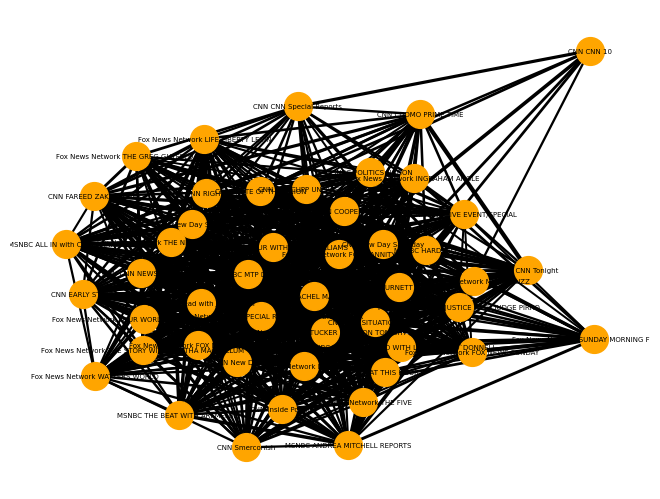

In [74]:


G=nx.from_pandas_edgelist(progdf[progdf["score"] > 0.014], 'pr1', 'pr2', edge_attr="score")
 
# Plot the network:
nx.draw(G, with_labels=True, node_color='orange', node_size=400, edge_color='black', linewidths=1, font_size=5, width = progdf[progdf["score"] > 0.014]['score'] * 100)

In [75]:
#converting to wide
progwd = progdf.pivot(index='pr1', columns='pr2', values='distance').fillna(0)
print(progwd["Fox News Network WATTERS WORLD"])

progwd2 = progdf.pivot(index='pr1', columns='pr2', values='score').fillna(0)
print(progwd2["Fox News Network WATTERS WORLD"])

pr1
CNN ANDERSON COOPER 360 DEGREES                        0.214767
CNN AT THIS HOUR                                       0.336128
CNN CNN 10                                             0.414921
CNN CNN LIVE EVENT/SPECIAL                             0.157242
CNN CNN NEWSROOM                                       0.240838
CNN CNN RIGHT NOW                                      0.293971
CNN CNN Special Reports                                0.146916
CNN CNN Tonight                                        0.263501
CNN CUOMO PRIME TIME                                   0.332713
CNN EARLY START                                        0.191954
CNN ERIN BURNETT OUTFRONT                              0.227740
CNN FAREED ZAKARIA GPS                                 0.195911
CNN Inside Politics                                    0.361646
CNN New Day                                            0.257264
CNN New Day Saturday                                   0.191429
CNN New Day Sunday                  

In [76]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca_df = pd.DataFrame(pca.fit(progwd).transform(progwd), columns = ['pca1','pca2'])
pca_df['Program'] = progwd.index
pca_df['Channel'] = pca_df['Program'].apply(lambda x: 'Fox' if 'Fox' in x else ('MSNBC' if 'MSNBC' in x else 'CNN'))
pca_df['Program'] = pca_df['Program'].apply(lambda x: x.replace('Fox News Network ',''))
pca_df['Program'] = pca_df['Program'].apply(lambda x: x.replace('CNN ',''))
pca_df['Program'] = pca_df['Program'].apply(lambda x: x.replace('MSNBC ',''))
print(pca_df)

pca = PCA(n_components=2)
pca_df2 = pd.DataFrame(pca.fit(progwd2).transform(progwd2), columns = ['pca1','pca2'])
pca_df2['Program'] = progwd2.index
pca_df2['Channel'] = pca_df2['Program'].apply(lambda x: 'Fox' if 'Fox' in x else ('MSNBC' if 'MSNBC' in x else 'CNN'))
pca_df2['Program'] = pca_df2['Program'].apply(lambda x: x.replace('Fox News Network ',''))
pca_df2['Program'] = pca_df2['Program'].apply(lambda x: x.replace('CNN ',''))
pca_df2['Program'] = pca_df['Program'].apply(lambda x: x.replace('MSNBC ',''))
print(pca_df2)

        pca1      pca2                                Program Channel
0  -0.164448  0.073434            ANDERSON COOPER 360 DEGREES     CNN
1   0.656274  0.257974                           AT THIS HOUR     CNN
2  -0.225570  0.416274                                     10     CNN
3  -0.072588  0.045826                     LIVE EVENT/SPECIAL     CNN
4   0.005189 -0.042705                               NEWSROOM     CNN
5   0.186214  0.008639                              RIGHT NOW     CNN
6   0.121209 -0.474419                        Special Reports     CNN
7  -0.057866 -0.143317                                Tonight     CNN
8   0.214831 -0.088293                       CUOMO PRIME TIME     CNN
9   0.179929 -0.173874                            EARLY START     CNN
10 -0.278734 -0.040201                  ERIN BURNETT OUTFRONT     CNN
11  0.626162 -0.345799                     FAREED ZAKARIA GPS     CNN
12  0.522972  0.187825                        Inside Politics     CNN
13  0.049824  0.0169

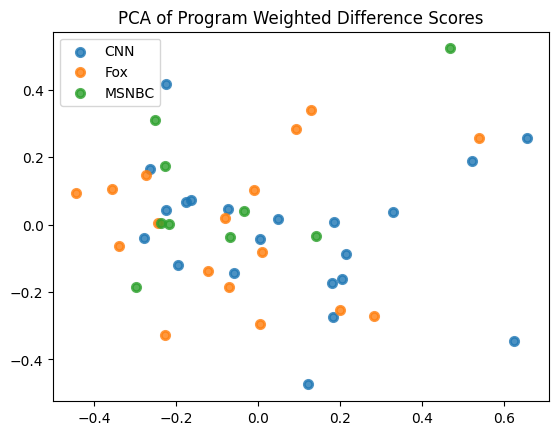

In [77]:
#weighted network of programs
plt.figure()
lw = 2

for c in pca_df['Channel'].unique():
    plt.scatter(
        pca_df[pca_df["Channel"] == c]["pca1"], pca_df[pca_df["Channel"] == c]["pca2"],  alpha=0.8, lw=lw, label=c
    )
"""for i in pca_df.index:
    if pca_df["Channel"][i] == "CNN" and (pca_df["pca1"][i] - pca_df["pca2"][i]) > 0.2:
        plt.text(x=pca_df.pca1[i]+0.01,y=pca_df.pca2[i]+0.01,s=pca_df.Program[i], 
            fontdict=dict(color='red',size=10),
            bbox=dict(facecolor='yellow',alpha=0.5))
    if pca_df["Channel"][i] == "Fox" and (pca_df["pca1"][i] - pca_df["pca2"][i]) < -0.095:
        plt.text(x=pca_df.pca1[i]+0.01,y=pca_df.pca2[i]+0.01,s=pca_df.Program[i], 
            fontdict=dict(color='red',size=10),
            bbox=dict(facecolor='yellow',alpha=0.5))"""
plt.legend(loc="best", shadow=False, scatterpoints=1)
plt.title("PCA of Program Weighted Difference Scores")



plt.show()

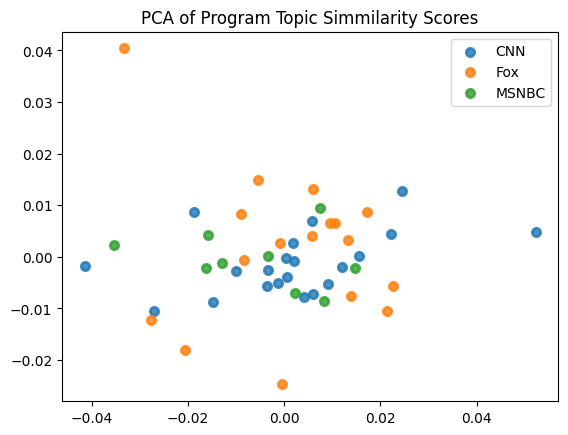

In [78]:
plt.figure()
lw = 2

for c in pca_df2['Channel'].unique():
    plt.scatter(
        pca_df2[pca_df2["Channel"] == c]["pca1"], pca_df2[pca_df2["Channel"] == c]["pca2"],  alpha=0.8, lw=lw, label=c
    )
"""for i in pca_df.index:
    if pca_df2.pca1[i] > 0.015 or pca_df2.pca2[i] < -0.01:
        plt.text(x=pca_df2.pca1[i]+0.001,y=pca_df2.pca2[i]+0.001,s=pca_df2.Program[i], 
          fontdict=dict(color='red',size=10),
          bbox=dict(facecolor='yellow',alpha=0.5))"""
plt.legend(loc="best", shadow=False, scatterpoints=1)
plt.title("PCA of Program Topic Simmilarity Scores")



plt.show()